# This notebook will be created for learning purposes, so a database different from the competition will be used!I will work with the old database provided by the competition.

In [1]:
!pip install scispacy
!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.2.4/en_core_sci_md-0.2.4.tar.gz

     |████████████████████████████████| 10.0MB 19.6MB/s 
     |████████████████████████████████| 13.0MB 245kB/s 
     |████████████████████████████████| 71kB 5.6MB/s 
     |████████████████████████████████| 2.1MB 49.7MB/s 
     |████████████████████████████████| 296kB 55.5MB/s 
  Found existing installation: thinc 7.4.0
    Uninstalling thinc-7.4.0:
      Successfully uninstalled thinc-7.4.0
  Found existing installation: spacy 2.2.4
    Uninstalling spacy-2.2.4:
      Successfully uninstalled spacy-2.2.4
     |████████████████████████████████| 70.0MB 43kB/s 
  Created wheel for en-core-sci-md: filename=en_core_sci_md-0.2.4-cp36-none-any.whl size=70498247 sha256=13076a4e21ab1f20b998c9195e7e9529c88718d625a35d3d09b3ed95c9ba5a8d
  Stored in directory: /root/.cache/pip/wheels/12/b3/89/7fbb30f56411e8b4002eac6d5568ab46da63191a2287aa17bf
Successfully built en-core-sci-md


In [2]:
import numpy as np
import pandas as pd
import glob
import json
import seaborn as sn
import spacy
import nltk
from IPython.core.display import HTML
from matplotlib import pyplot as plt
import scispacy
import en_core_sci_md
!python -m spacy download en

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
/usr/local/lib/python3.6/dist-packages/spacy/util.py:275: UserWarning: [W031] Model 'en_core_sci_md' (0.2.4) requires spaCy v2.2 and is incompatible with the current spaCy version (2.3.2). This may lead to unexpected results or runtime errors. To resolve this, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


     |████████████████████████████████| 12.1MB 1.3MB/s 
  Created wheel for en-core-web-sm: filename=en_core_web_sm-2.3.1-cp36-none-any.whl size=12047111 sha256=ebf8a9c4706da1876c5d278d8a4349bac8ba0d3a77a475e73afee7bedd115af0
  Stored in directory: /tmp/pip-ephem-wheel-cache-gmwqmfrb/wheels/2b/3f/41/f0b92863355c3ba34bb32b37d8a0c662959da0058202094f46
Successfully built en-core-web-sm
  Found existing installation: en-core-web-sm 2.2.5
    Uninstalling en-core-web-sm-2.2.5:
      Successfully uninstalled en-core-web-sm-2.2.5
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_sm')
✔ Linking successful
/usr/local/lib/python3.6/dist-packages/en_core_web_sm -->
/usr/local/lib/python3.6/dist-packages/spacy/data/en
You can now load the model via spacy.load('en')


In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [4]:
import zipfile
path = '/content/gdrive/My Drive/CORD-19-research-challenge.zip'
zip_object = zipfile.ZipFile(file=path, mode = 'r')
zip_object.extractall('./')
zip_object.close()

Define the columns that we will access:

In [5]:
corona_features = {'paper_id': [], 'title': [],
                   'abstract': [], 'text': []}

Now let's transform from dictionary to dataframe:

In [6]:
corona_df = pd.DataFrame.from_dict(corona_features)

In [7]:
#the json files:
json_filenames = glob.glob(f'{"./"}//**/*.json', recursive = True)

In [8]:
len(json_filenames)

58633

My computer is really limitated so I will reduce the ``json_filenames`` to get easier to make the codes.

In [9]:
import random
json_filenames = random.sample(json_filenames, k = 10000)

In [10]:
print(json_filenames)

['./gdrive/My Drive/COVID-19/custom_license/5307ab57d5733bc587d3dbe89e5d8e1b944f3670.json', './custom_license/custom_license/1d94975c65d36c72fb7f6fe29e1ee26c4a432ab6.json', './custom_license/custom_license/c6dfd2dc5940e056c25912b1bfd75288b1851b7d.json', './gdrive/My Drive/COVID-19/custom_license/b395a9a8543d761080d47718952a4d33290e1f3b.json', './gdrive/My Drive/COVID-19/custom_license/399391f9de3c276725bb184bb11d8e051a776916.json', './gdrive/My Drive/COVID-19/custom_license/62d10de64f2b3079255dcd39ee655e62e4e217e8.json', './custom_license/custom_license/a141853a697536211afce4eea74390785e288f42.json', './custom_license/custom_license/3c81c1c3cc400548820f0d58a97ff90465e906f9.json', './gdrive/My Drive/COVID-19/custom_license/e11bd83bc9ade0e9b52c309828a96cc4214d55c4.json', './comm_use_subset/comm_use_subset/c751c8772ce889d767d8896227d82d3f8f5f3bab.json', './custom_license/custom_license/d91309c626bee9f334d920c613e183f4bdbac2cc.json', './gdrive/My Drive/COVID-19/custom_license/798c10946a827

The function to fill the ``corona_df``:

In [11]:
def return_corona_df(json_filenames, df):
  for file_name in json_filenames:
    row = {'paper_id': None, 'title': None,
           'abstract': None, 'text': None}
    
    with open(file_name) as json_data:
      if file_name == './sample_data/anscombe.json':
        continue

      data = json.load(json_data)

      row['paper_id'] = data['paper_id'].strip() # ' 345 ' -> '345'
      row['title'] = data['metadata']['title'].strip()

      abstract_list = [abstract['text'] for abstract in data['abstract']]
      abstract = '\n '.join(abstract_list)
      row['abstract'] = abstract.strip()

      text_list = [text['text'] for text in data['body_text']]
      text = '\n '.join(text_list)
      row['text'] = text.strip()

      df = df.append(row, ignore_index = True)
  return df

In [12]:
corona_df = return_corona_df(json_filenames, corona_df)

In [13]:
corona_df.head()

,paper_id,title,abstract,text
0,5307ab57d5733bc587d3dbe89e5d8e1b944f3670,Frameshifting RNA pseudoknots: Structure and m...,Programmed ribosomal frameshifting (PRF) is on...,Ribonucleic acid (RNA) molecules adopt tertiar...
1,1d94975c65d36c72fb7f6fe29e1ee26c4a432ab6,Dideoxy fluoro-ketopyranosyl nucleosides as po...,The synthesis of the dideoxy fluoro ketopyrano...,The synthesis of the dideoxy fluoro ketopyrano...
2,c6dfd2dc5940e056c25912b1bfd75288b1851b7d,,,"SIR,-ProfessQr Dudley attributes to "" the weig..."
3,b395a9a8543d761080d47718952a4d33290e1f3b,Macroeconomic Effect of Infectious Disease Out...,,Infectious disease outbreaks such as pandemic ...
4,399391f9de3c276725bb184bb11d8e051a776916,Organisation de la réanimation en situation de...,The influenza pandemic will create a major inc...,Disponible en ligne sur www.sciencedirect.com\...


In [14]:
corona_df.to_csv('corona_df_complete.csv')

Let see if the code made the correct way to search the article:

In [15]:
corona_df['text'][0]

'Ribonucleic acid (RNA) molecules adopt tertiary structures of rich complexity and functional diversity (Holbrook, 2005) . In messenger RNAs, 5 and 3 untranslated regions (UTRs) posttranscriptionally control gene expression by regulating RNA processing and translation initiation (Jenner et al., 2005) . 5 UTRs also fold into metabolite-sensing RNA elements termed riboswitches that recognize specific metabolites and thereby regulate transcription termination/anti-termination or translation initiation in bacteria Wakeman et al., 2007; Winkler et al., 2002) .\n Since its discovery in the 3 ends of certain plant viral genomic RNAs by the Dutch groups of Pleij, Rietveld and Bosch in the early to mid-1980s (Pleij et al., 1985; Rietveld et al., 1984 Rietveld et al., , 1983 ) and subsequent NMR structural characterization (Kolk et al., 1998) , the RNA pseudoknot is now recognized as a ubiquitous folding topology that performs a wide range of functions in biology. RNA pseudoknotting is found in 

# The missing values:

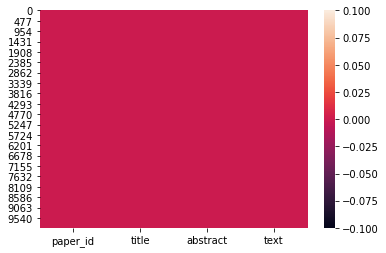

In [16]:
sn.heatmap(corona_df.isnull());

Thsis unique color means that we don't have missinf values. But we will make  another verification because we are working with texts files and we don't have a 'NaN', in text is more comun te blank space, so we have to see how many blanck space the ``corona_df`` count have:

In [17]:
len(corona_df[corona_df['paper_id'] == ''])

0

Okay! How we can see, all the files have a ``paper_id``. Now let's see with the others features:

In [18]:
len(corona_df[corona_df['title'] == ''])

1245

In [19]:
len(corona_df[corona_df['abstract'] == ''])

2750

In [20]:
len(corona_df[corona_df['text'] == ''])

0

The ``title`` and the ``abstract`` have blank spaces so we will to delete them from the database

In [21]:
corona_df = corona_df[corona_df['title'] != '']
corona_df = corona_df[corona_df['abstract'] != '']

# Duplicate Values

In [22]:
corona_df.drop_duplicates(['abstract', 'text', 'title'], inplace = True)

# Sample of the database

We will reduce the `` corona_df`` to a sample of only 400, so that it will take less time to run the information. If we used the entire database, it would take us much more time and in this step the important thing is to know more about the data and obtain better information so a sample will be sufficient and more practical!

In [23]:
corona_df = corona_df.sample(n = 1500, random_state = 1)
corona_df.head()

,paper_id,title,abstract,text
2625,018b5b5f732e955d349e14a83481739502ae104c,Potential risk of viral transmission from flyi...,Flying foxes have been considered to be involv...,doi: 10 .1292/jvms. to hunt wild boars or as g...
9387,f641d2a5c37c69037e55f3e49ef79daa7dca0834,Seroepidemiological and clinical survey of fel...,Four hundred and thirty-nine feline serum samp...,from several cats exhibiting signs of immunode...
5232,2735c2e5b493fd4e7b7c4ec3d44a775f9399aa0d,Enhancing Time-Series Detection Algorithms for...,BioSense is a US national system that uses dat...,"S ince the late 1990s, the threats of bioterro..."
262,ca1a69ee197dec6b6bb23168cc6897249c234d52,Quantitative sense-specific determination of m...,"In many applications, it is useful to know the...","In the course of many experiments in virology,..."
2557,28d987c4ec40dafc05993e3a209ea4266f270f28,SUPPLEMENTAL TEXT MATERIALS AND METHODS,A draft genome was produced using reads from b...,MAKER. Gene models were first predicted using ...


Let's see a sample of one of the `` text``:

In [25]:
sample_text = corona_df['text'][2625]
sample_text

"doi: 10 .1292/jvms. to hunt wild boars or as guard dogs, such that the population of dogs in Garut is comparatively high in Indonesia. A huge nature conservation area, Leuweung Sancang (2,157 hectares), is located on the south coast of Garut District [17] , as shown in Fig. 1 .\n Inside the conserved area, many large trees serve as roosting sites for thousands of flying foxes during the daytime. At night, flying foxes from the reserve roam throughout the area in search of food, including in residential zones surrounding the conservation area. Direct and/or indirect contacts between flying foxes, domestic animals and humans in these residential areas potentiate the transmission of viruses from flying foxes to other animals [29] . Direct contacts refer to physical touch between a flying fox and another animals, whereas indirect contact is mediated via physical contact with the urine, feces or body fluids of flying foxes.\n Rabies among both humans and animals remains problematic in Garu

## Now let's go to the stage where we will use the `` en_core_sci_md`` to filter scientific texts for better use by health professionals when searching for information.

In [26]:
nlp = en_core_sci_md.load(disable=['tagger', 'parser', 'ner'])
nlp.max_length = 2000000 #not setting a size limit can cause memory problems on your machine

/usr/local/lib/python3.6/dist-packages/spacy/util.py:275: UserWarning: [W031] Model 'en_core_sci_md' (0.2.4) requires spaCy v2.2 and is incompatible with the current spaCy version (2.3.2). This may lead to unexpected results or runtime errors. To resolve this, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


Now let's go to the `` STOP_WORDS``, which are the words that are not very important!

In [27]:
print(spacy.lang.en.stop_words.STOP_WORDS)

{'own', 'each', '’ll', 'and', 'go', 'over', 'using', 'some', 'sometime', 'another', 'how', 'does', 'neither', 'amount', 'at', 'the', 'whatever', 'against', 'top', 'least', 'behind', 'towards', 'who', 'rather', 'whereupon', 'n‘t', 'latter', 'because', 'otherwise', 'fifteen', '‘re', 'done', 'many', 'serious', 'was', 'is', 'enough', 'whether', 'sometimes', 'several', 'everywhere', 'too', 'were', 'via', 'twelve', 'be', 'becomes', 'have', 'though', 'beyond', 'less', 'call', 'thereby', 'whereafter', 'herein', 'most', 'these', 'off', '‘ll', '’m', 'former', 'about', 'alone', 'themselves', 'last', 'eight', 'him', 'ever', 'name', 'therefore', 'also', 'due', 'get', 'may', 'made', 'that', 'anyhow', 'seem', 'we', 'used', 'whence', 'whole', 'much', 'see', 'within', 'only', 'really', 'wherever', 'by', 'mostly', 'it', 'become', 'keep', 'beforehand', 'might', 'everyone', 'back', 'between', 'nothing', 'her', 'a', 'onto', 'since', 'doing', 'two', 'mine', 'herself', 'whereby', 'one', 'say', 'will', 'empty

Let see how many stop words we have:

In [28]:
len(spacy.lang.en.stop_words.STOP_WORDS)

326

We will delete these stop words:

In [29]:
def spacy_tokenizer(sentence):
  sentence = sentence.lower()
  list = []
  list = [word.lemma_ for word in nlp(sentence) if not (word.is_stop or word.like_num or word.is_punct or word.is_space)]
  list = ' '.join([str(element) for element in list])

  return list

In [30]:
test = sample_text
result = spacy_tokenizer(test)
result

'doi .1292/jvms hunt wild boar guard dog population dog garut comparatively high indonesia huge nature conservation area leuweung sancang hectare locate south coast garut district show fig. inside conserve area large tree serve roost site thousand fly fox daytime night fly fox reserve roam area search food include residential zone surround conservation area direct and/or indirect contact fly fox domestic animal human residential area potentiate transmission virus fly fox animal direct contact refer physical touch fly fox animal indirect contact mediate physical contact urine feces body fluid fly fox rabies human animal remain problematic garut district west java case people bite dog death death district garut previous case human rabies think associate dog fly fox indonesia carry lyssaviruses cause disease closely resemble paralytic rabies aim study determine survey contact fly fox domestic animal human residential area roost site assess potential viral transmission especially rabies-re

To see the diference after the code:

In [31]:
sample_text

"doi: 10 .1292/jvms. to hunt wild boars or as guard dogs, such that the population of dogs in Garut is comparatively high in Indonesia. A huge nature conservation area, Leuweung Sancang (2,157 hectares), is located on the south coast of Garut District [17] , as shown in Fig. 1 .\n Inside the conserved area, many large trees serve as roosting sites for thousands of flying foxes during the daytime. At night, flying foxes from the reserve roam throughout the area in search of food, including in residential zones surrounding the conservation area. Direct and/or indirect contacts between flying foxes, domestic animals and humans in these residential areas potentiate the transmission of viruses from flying foxes to other animals [29] . Direct contacts refer to physical touch between a flying fox and another animals, whereas indirect contact is mediated via physical contact with the urine, feces or body fluids of flying foxes.\n Rabies among both humans and animals remains problematic in Garu

We will now apply the function to the entire database:

In [32]:
corona_df['text'] = corona_df['text'].apply(spacy_tokenizer)
print(sample_text)

doi: 10 .1292/jvms. to hunt wild boars or as guard dogs, such that the population of dogs in Garut is comparatively high in Indonesia. A huge nature conservation area, Leuweung Sancang (2,157 hectares), is located on the south coast of Garut District [17] , as shown in Fig. 1 .
 Inside the conserved area, many large trees serve as roosting sites for thousands of flying foxes during the daytime. At night, flying foxes from the reserve roam throughout the area in search of food, including in residential zones surrounding the conservation area. Direct and/or indirect contacts between flying foxes, domestic animals and humans in these residential areas potentiate the transmission of viruses from flying foxes to other animals [29] . Direct contacts refer to physical touch between a flying fox and another animals, whereas indirect contact is mediated via physical contact with the urine, feces or body fluids of flying foxes.
 Rabies among both humans and animals remains problematic in Garut D

In [33]:
print(corona_df['text'][2625])

doi .1292/jvms hunt wild boar guard dog population dog garut comparatively high indonesia huge nature conservation area leuweung sancang hectare locate south coast garut district show fig. inside conserve area large tree serve roost site thousand fly fox daytime night fly fox reserve roam area search food include residential zone surround conservation area direct and/or indirect contact fly fox domestic animal human residential area potentiate transmission virus fly fox animal direct contact refer physical touch fly fox animal indirect contact mediate physical contact urine feces body fluid fly fox rabies human animal remain problematic garut district west java case people bite dog death death district garut previous case human rabies think associate dog fly fox indonesia carry lyssaviruses cause disease closely resemble paralytic rabies aim study determine survey contact fly fox domestic animal human residential area roost site assess potential viral transmission especially rabies-rel

As we can see, there have been changes! If we buy with `` print (sample_text) `` and `` print (corona_df ['text'][1019] ``. Note that our commands were performed correctly.

In [34]:
print(len(sample_text), len(corona_df['text'][2625]))

20137 12108


# Frequent terms

The first step will be to create a ``.txt`` for each of the texts, that is, we have 400 texts and each one of them will be represented by a ``.txt`` file

In [35]:
for index, row in corona_df.iterrows():
  print(row['paper_id'], row['title'])
  text_file = open('corpus/' + row['paper_id'] + '.txt', 'w')
  n = text_file.write(row['text'])
  text_file.close()

018b5b5f732e955d349e14a83481739502ae104c Potential risk of viral transmission from flying foxes to domestic animals and humans on the southern coast of West Java, Indonesia
f641d2a5c37c69037e55f3e49ef79daa7dca0834 Seroepidemiological and clinical survey of feline immunodeficiency virus infection in northern Italy
2735c2e5b493fd4e7b7c4ec3d44a775f9399aa0d Enhancing Time-Series Detection Algorithms for Automated Biosurveillance
ca1a69ee197dec6b6bb23168cc6897249c234d52 Quantitative sense-specific determination of murine coronavirus RNA by reverse transcription polymerase chain reaction
28d987c4ec40dafc05993e3a209ea4266f270f28 SUPPLEMENTAL TEXT MATERIALS AND METHODS
3e8286a0531a46c267f34d20e60a4754c2391a09 Case Report Central Hypoventilation: A Case Study of Issues Associated with Travel Medicine and Respiratory Infection
bddfc27eab5ed01ee09fcab0f11fd6c0a0bd458e Middle East Respiratory Syndrome Coronavirus Quasispecies That Include Homologues of Human Isolates Revealed through Whole- Genome

Let's use `` nltk`` to read these files to create the corpus with the texts.

In [36]:
from nltk.corpus import PlaintextCorpusReader
corpus = PlaintextCorpusReader('corpus', '.*')

In [37]:
file = corpus.fileids()
file[0]

'00352a58c8766861effed18a4b079d1683fec2ec.txt'

In [38]:
corpus.raw('00352a58c8766861effed18a4b079d1683fec2ec.txt')

'ubiquitination widely posttranslational modification emerge key regulator synapse development function diantonio hicke mabb ehlers ubiquitination grow list pre-and postsynaptic protein regulate stability function subcellular localization mabb ehlers bingol sheng kowalski juo covalent attachment ubiquitin lysine residue target protein catalyze sequence enzymatic reaction mediate e1 ubiquitin-activating enzyme e2 ubiquitin-conjugating enzyme e3 ubiquitin ligase hershko ciechanover ubiquitin lysine residue primary amine n-terminus utilize form ubiquitin chain monoubiquitination polyubiquitination chain-linkage type create distinct structural topology recognize ubiquitin bind protein mediate function ubiquitin example lys48-and lys11-linked polyubiquitination result proteasomal degradation lys63-linked polyubiquitination typically associate signal endo-lysosomal traffic piper lehner clague et al. nathan et al. ubiquitin remove substrate protease call deubiquitinating enzyme dub human geno

Now we can view the most frequent terms:

In [39]:
words = corpus.words()
print(words)

['ubiquitination', 'widely', 'posttranslational', ...]


In [40]:
len(words)

4568509

I will count how many times the words appear

In [41]:
frequency = nltk.FreqDist(words)
most_common = frequency.most_common(100)
most_common

[('-', 187066),
 ('.', 71627),
 ('cell', 38297),
 ('/', 31747),
 ('virus', 27471),
 ('et', 25798),
 ('al', 25316),
 ('protein', 22250),
 ('study', 21394),
 ('infection', 20254),
 ('c', 15020),
 ('result', 14631),
 ('show', 14572),
 ('viral', 12850),
 ('high', 12632),
 ('patient', 12017),
 ('disease', 11938),
 ('sequence', 11407),
 ('datum', 11248),
 ('fig', 11204),
 ('gene', 11106),
 ('sample', 10845),
 ('1', 10788),
 ('group', 10459),
 ('include', 10221),
 ('human', 10209),
 ('time', 9825),
 ('increase', 9584),
 ('test', 9405),
 ('p', 9366),
 ('control', 9362),
 ('s', 9336),
 ('analysis', 9115),
 ('level', 9046),
 ('report', 9004),
 ('model', 8779),
 ('case', 8762),
 ('n', 8707),
 ('day', 8478),
 ('e', 8411),
 ('t', 8370),
 ('response', 8289),
 ('b', 8288),
 ('mouse', 8251),
 ('rna', 8251),
 ('effect', 8016),
 ('different', 7999),
 ('strain', 7988),
 ('type', 7987),
 ('h', 7909),
 ('find', 7811),
 ('g', 7809),
 ('system', 7696),
 ('activity', 7685),
 ('figure', 7678),
 ('antibody', 76

# Word cloud

In [42]:
from matplotlib.colors import ListedColormap
color_map = ListedColormap(['orange', 'green', 'red', 'magenta'])
from wordcloud import WordCloud
cloud = WordCloud(background_color = 'white', max_words=100, colormap=color_map)

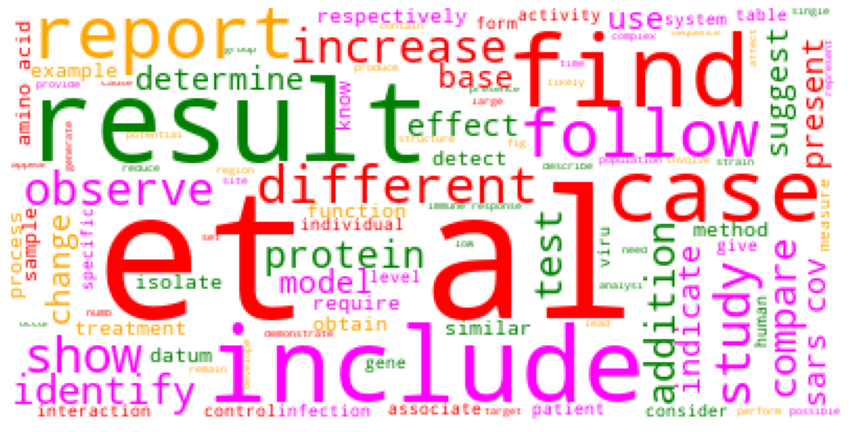

In [43]:
cloud = cloud.generate(corona_df['text'].str.cat(sep='\n'))
plt.figure(figsize=(15,15))
plt.imshow(cloud)
plt.axis('off')
plt.show()

# Small adjustments to the `` STOP_WORDS`` function

An improvement will be made so that we can see even better results

In [44]:
new_stop_words = ['et', 'al', 'doi', 'copyright',  'http', 'https', 'fig', 'table', 'result', 'show']
for word in new_stop_words:
  nlp.vocab[word]

**Here we are going to repeat the whole process that was done previously**

In [45]:
def spacy_tokenizer(sentence):
  sentence = sentence.lower()
  list = []
  list = [word.lemma_ for word in nlp(sentence) if not (word.is_stop or word.like_num or word.is_punct or word.is_space)]
  list = ' '.join([str(element) for element in list])

  return list

In [46]:
corona_df['text'] = corona_df['text'].apply(spacy_tokenizer)

In [47]:
for index, row in corona_df.iterrows():
  print(row['paper_id'], row['title'])
  text_file = open('corpus2/' + row['paper_id'] + '.txt', 'w')
  n = text_file.write(row['text'])
  text_file.close()

018b5b5f732e955d349e14a83481739502ae104c Potential risk of viral transmission from flying foxes to domestic animals and humans on the southern coast of West Java, Indonesia
f641d2a5c37c69037e55f3e49ef79daa7dca0834 Seroepidemiological and clinical survey of feline immunodeficiency virus infection in northern Italy
2735c2e5b493fd4e7b7c4ec3d44a775f9399aa0d Enhancing Time-Series Detection Algorithms for Automated Biosurveillance
ca1a69ee197dec6b6bb23168cc6897249c234d52 Quantitative sense-specific determination of murine coronavirus RNA by reverse transcription polymerase chain reaction
28d987c4ec40dafc05993e3a209ea4266f270f28 SUPPLEMENTAL TEXT MATERIALS AND METHODS
3e8286a0531a46c267f34d20e60a4754c2391a09 Case Report Central Hypoventilation: A Case Study of Issues Associated with Travel Medicine and Respiratory Infection
bddfc27eab5ed01ee09fcab0f11fd6c0a0bd458e Middle East Respiratory Syndrome Coronavirus Quasispecies That Include Homologues of Human Isolates Revealed through Whole- Genome

In [48]:
from nltk.corpus import PlaintextCorpusReader
corpus = PlaintextCorpusReader('corpus2', '.*')

In [49]:
words = corpus.words()
print(words)

['ubiquitination', 'widely', 'posttranslational', ...]


In [50]:
len(words)

4528306

In [51]:
frequency = nltk.FreqDist(words)
most_common = frequency.most_common(100)
most_common

[('-', 187060),
 ('.', 71625),
 ('cell', 38297),
 ('/', 31747),
 ('virus', 27471),
 ('et', 25798),
 ('al', 25316),
 ('protein', 22250),
 ('study', 21394),
 ('infection', 20254),
 ('c', 15020),
 ('result', 14631),
 ('viral', 12850),
 ('high', 12632),
 ('patient', 12017),
 ('disease', 11938),
 ('sequence', 11407),
 ('datum', 11248),
 ('fig', 11204),
 ('gene', 11106),
 ('sample', 10853),
 ('1', 10784),
 ('group', 10469),
 ('include', 10221),
 ('human', 10209),
 ('time', 9827),
 ('find', 9717),
 ('increase', 9584),
 ('test', 9406),
 ('p', 9366),
 ('control', 9362),
 ('s', 9336),
 ('analysis', 9115),
 ('level', 9046),
 ('report', 9004),
 ('model', 8779),
 ('case', 8764),
 ('n', 8707),
 ('day', 8478),
 ('e', 8411),
 ('t', 8370),
 ('response', 8289),
 ('b', 8288),
 ('mouse', 8251),
 ('rna', 8251),
 ('effect', 8016),
 ('different', 7999),
 ('strain', 7988),
 ('type', 7987),
 ('numb', 7937),
 ('h', 7909),
 ('g', 7822),
 ('system', 7696),
 ('activity', 7685),
 ('figure', 7678),
 ('antibody', 767

In [52]:
color_map = ListedColormap(['orange', 'green', 'red', 'magenta'])
cloud = WordCloud(background_color = 'white', max_words=100, colormap=color_map)

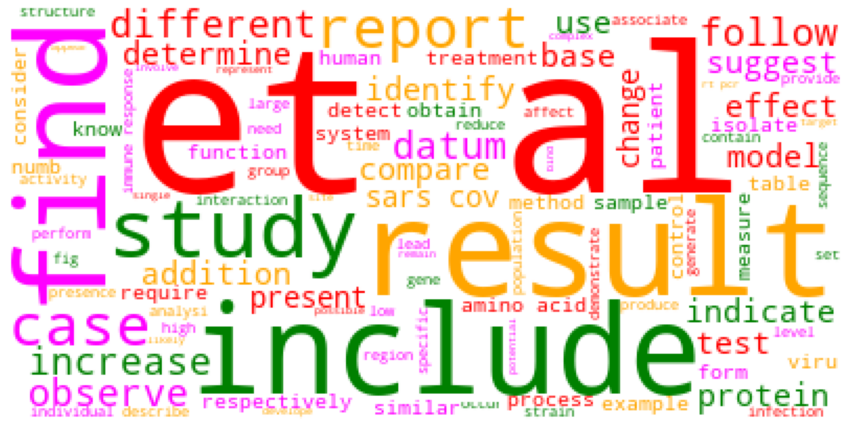

In [53]:
cloud = cloud.generate(corona_df['text'].str.cat(sep='\n'))
plt.figure(figsize=(15,15))
plt.imshow(cloud)
plt.axis('off')
plt.show()

Let's create a `` .csv`` file so that it is not necessary to keep running the code.

In [54]:
corona_df.to_csv('corona_df_sample.csv')

# Recognizing named entities

Here we will make a visualization of how to "track" in the text the entities that you are interested in knowing.

In [55]:
text = str(corona_df['text'][2625])
print(text)

doi .1292/jvms hunt wild boar guard dog population dog garut comparatively high indonesia huge nature conservation area leuweung sancang hectare locate south coast garut district fig. inside conserve area large tree serve roost site fly fox daytime night fly fox reserve roam area search food include residential zone surround conservation area direct and/or indirect contact fly fox domestic animal human residential area potentiate transmission virus fly fox animal direct contact refer physical touch fly fox animal indirect contact mediate physical contact urine feces body fluid fly fox rabies human animal remain problematic garut district west java case people bite dog death death district garut previous case human rabies think associate dog fly fox indonesia carry lyssaviruses cause disease closely resemble paralytic rabies aim study determine survey contact fly fox domestic animal human residential area roost site assess potential viral transmission especially rabies-related lyssaviru

In [56]:
nlp_ent = spacy.load('en')
nlp_ent.max_length = 2000000
doc = nlp_ent(text)

In [57]:
for entity in doc.ents:
  if entity.label_ == 'NORP' or entity.label_ == 'GPE': #best codes to use for our goal
    print(entity.text, entity.label_)

indonesia GPE
indonesia GPE
indonesia GPE
west java province GPE
indonesia GPE
jakarta GPE
australian NORP
australian NORP
japanese NORP
australia GPE
indonesia GPE
southeast asian NORP


In [58]:
from spacy import displacy
displacy.render(doc, style = 'ent', jupyter = True)

**The above text is shown with colored words, meaning precisely the entities that have been recognized, which facilitates searches when searching.**

## Counting how many entities the database has

Let’s focus on doing a search for the countries most cited in the texts.

In [59]:
gpe = []
for index, row in corona_df.iterrows():
  text = row['text']
  doc = nlp_ent(text)
  for entity in doc.ents:
    if entity.label_ == 'GPE':
      gpe.append(str(entity.text))

In [60]:
print(gpe)

['indonesia', 'indonesia', 'indonesia', 'west java province', 'indonesia', 'jakarta', 'australia', 'indonesia', 'hou', 'north italy', 'al.', 'borderline arc', 'comm', 'ed', '1-specifi city', 'strand', 'strand', 'chicago', 'strand', 'k00757', 'encode', 'strand', 'tuba1', 'ammonia', 'hong kong', 'hong kong', 'toronto', 'canada', 'toronto', 'hong kong', 'hong kong', 'hong kong', 'saudi arabia', 'saudi arabia', 'jx869059', 'germany', 'san diego usa', 'strand', 'new zealand', 'p(i', 'southeast mexico', 'canada', 'australia', 'brazil', 'canada', 'costa rica', 'ecuador el salvador', 'france', 'germany', 'israel', 'japan', 'mexico', 'panama', 'peru', 'spain', 'kingdom', 'mexico', 'mexico', 'province city district', 'pediatrician', 'terminalia', 'neutrophil', 'neutrophil', 'pakistan', 'pakistan', 'texas', 'encode', 'vp2', 'goat guinea', 'encode', 'encode', 'anti-hjam1', 'fcv', 'indianapolis', 'vp2', 'prepare guinea', 'describe guinea', 'guinea', 'san diego', 'gaithersburg', 'kingdom', 'pfa min'

In [61]:
values_gpe, counts_gpe = np.unique(np.array(gpe), return_counts = True)
gpe_df = pd.DataFrame({'value': values_gpe, 'counts': counts_gpe})
gpe_df.head()

,value,counts
0,$,3
1,-(e,1
2,--20,1
3,-and,1
4,-australasia,1


Let's make a filter to improve our visualization and be able to see only those that appear more often:

In [67]:
gpe_df_filtered = gpe_df[gpe_df.counts > 75]
gpe_df_filtered.head(15)

,value,counts
150,al.,211
347,australia,96
431,beijing,225
507,brazil,144
575,california,114
586,canada,139
673,china,1662
1090,encode,94
1325,fcov,88
1379,formalin,87


**Seeing all this in a bar graph:**

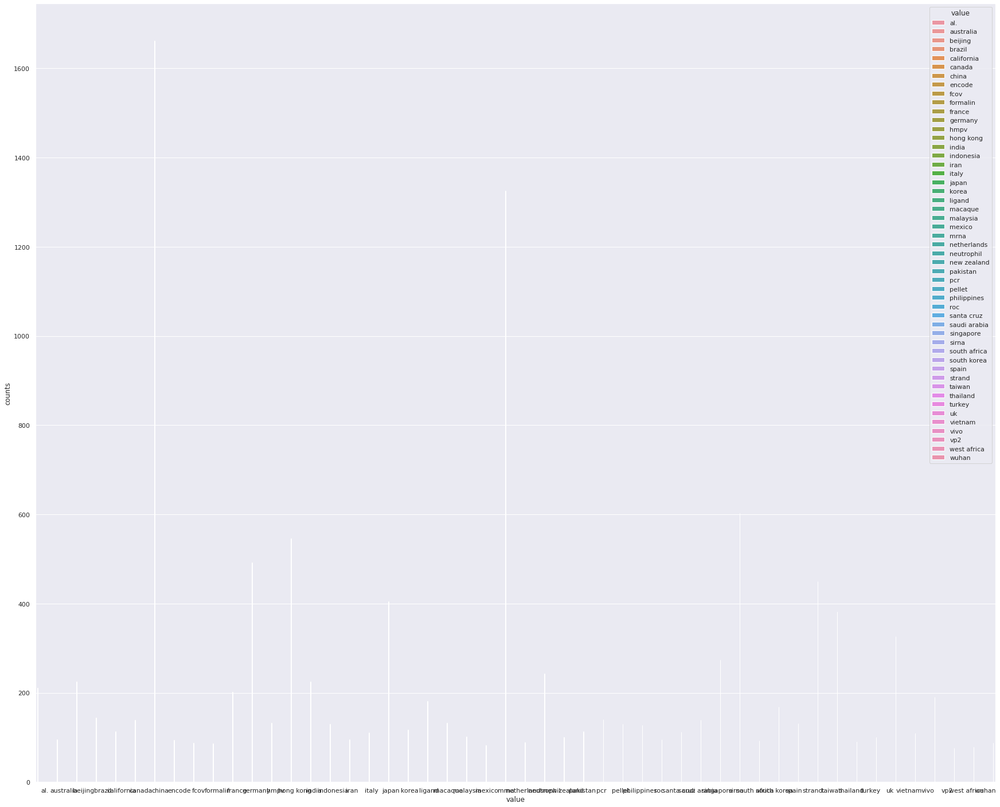

In [161]:
sn.set(rc = {'figure.figsize': (30,25)})
sn.barplot(x = 'value', y = 'counts', hue = 'value', data = gpe_df_filtered);

# Working with texts for research (key words)

### What do we know about COVID-19 risk factors?

- Smoking, 
- pre-existing pulmonary disease
- Co-infections (determine whether co-existing respiratory/viral infections make the virus more transmissible or virulent) and other - co-morbidities
- Neonates and pregnant women
- Socio-economic and behavioral factors to understand the economic impact of the virus and whether there were differences

### What do we know about non-pharmaceutical interventions?

- Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases.
Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments.

#Making search with only one word and NLTK:

In [69]:
text = nltk.Text(corpus.words())
match = text.concordance('pulmonary', width = 150, lines=30) #here we put the word we want to search

Displaying 30 of 815 matches:
te systolic murmur disclosure report accuracy noninvasively determine pulmonary artery pressure dog myxomatous mitral valve disease mmvd measurement 
evaluation thoracic radiograph cat divide group chf group cardiogenic pulmonary edema group pleural effusion group frequency eat group compare chisqu
ure disclosure report use cut balloon technique treatment subvalvular pulmonary stenosis m . perego s . lombardo r . santilli clinica veterinaria mal
 purpose study evaluate effect pharmacologically induce airway narrow pulmonary deposition nebulized radiopharmaceutical ie distribution healthy dog 
obtain 2 - dimensional speckle track echocardiography healthy dog dog pulmonary hypertension identify dog pulmonary hypertension additionally examine
 echocardiography healthy dog dog pulmonary hypertension identify dog pulmonary hypertension additionally examine relationship transverse strain stra
healthy dog tricuspid regurgitation tr velocity leave atrial size dog 

In [70]:
match = text.concordance('smoking', width = 150, lines=30)

Displaying 6 of 6 matches:
ase tobacco consumption example researcher predict young man die annum smoking - related disease 21st century forecast death annum country japan situ
nlikely strength tobacco industry one - third china man die eventually smoking - related condition respiratory disease note strong smoking - related 
eventually smoking - related condition respiratory disease note strong smoking - related dimension result coal burn relate factor nutrition intake ma
erium specimen throat swab cough device specimen collect healthy non - smoking subject normal control separately sputum specimen cough device specime
ention trial rural area kintampo ghana jack et al . start august non - smoking pregnant woman enroll graph woman enroll week gestation randomize rece
de baseline tobacco control framework convention alliance party anti - smoking activity need boost usmanova mokdad expand shisha use common region mo


# Making search with only one word and use using the FIND:

In [71]:
string = 'continuous hour result summarize table s1 asthma chronic obstructive pulmonary disease chronic cough cystic fybrosis idiopathic pulmonary fibrosis'
search_string = 'pulmonary'
print(string.find(search_string))

69


In [72]:
#shows the position at which the word starts:
string[69]

'p'

From the key word we are looking for, we have texts before it (left) and after it (right). Now let's see how you can see the texts to the left and right.

In [73]:
string[69:69+15] #to the right

'pulmonary disea'

In [74]:
string[69-15:69] #to the left

'ic obstructive '

In [75]:
string[69:48+10000]

'pulmonary disease chronic cough cystic fybrosis idiopathic pulmonary fibrosis'

Let's create a function that will return the number of times that our word appears

In [76]:
#Code based on https://www.journaldev.com/23666/python-string-find
def find_texts(input_str, search_str, number_of_words):
  l = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return l
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    l.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return l

In [77]:
texts = find_texts(string, search_string, 50)
texts

['ult summarize table s1 asthma chronic obstructive pulmonary disease chronic cough cystic fybrosis id',
 ' disease chronic cough cystic fybrosis idiopathic pulmonary fibrosis']

In [78]:
display(HTML(f'<h1>{search_string.upper()}</h1>'))
display(HTML(f"""<p><strong>Number of matches:</strong> {len(texts)}</p>"""))
for i in texts:
  marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

## Making the application in the database:

In [79]:
#here in this example it returns what is closest
search_string = 'Smoking'
search_string = spacy_tokenizer(search_string)
search_string

'smoke'

In [80]:
search_string = 'pulmonary disease'
search_string = spacy_tokenizer(search_string)
search_string

'pulmonary disease'

In [81]:
def find_all_texts(input_str, search_str, number_of_words):
  text_list = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return text_list
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    text_list.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return text_list

In [82]:
documents = []
for index, row in corona_df.iterrows():
  documents.append(find_all_texts(row['text'], search_string, 40)) # you can change the "search_string" for the word you wanna to search

In [83]:
for doc in documents:
  if doc != []:
    print(doc)

['tial problem arise travel include cardiopulmonary disease mortality injury accid']
['ctious cause asthma chronic obstructive pulmonary disease interstitial lung dise']
['se evidence suggest chronic obstructive pulmonary disease relate early childhood']
['k factor age > year chronic obstructive pulmonary disease copd patient bronchial']
['ease include asthma chronic obstructive pulmonary disease copd acute lung injury']
['lammation arthritis chronic obstructive pulmonary disease copd asthma crohn dise']
['ung transplantation chronic obstructive pulmonary disease copd reactive oxygen s']
['stive heart failure chronic obstructive pulmonary disease rheumatoid arthritis c', 'egular hemodialysis chronic obstructive pulmonary disease patient diabetes melli', 'numb parenthesis percentage obstructive pulmonary disease congestive heart failu', 'de fever suggest absence underlie cardiopulmonary disease patient present cough ']
['nd china adult h1n1 patient age chronic pulmonary disease appearan

Here a function will be created where the visualization will be done in `` HTLM`` and with identification of the article:

In [84]:
for index, row in corona_df.iterrows():
  texts = find_all_texts(row['text'], search_string, 400)
  if texts == []:
    continue
  
  paper_id = row['paper_id']
  title = row['title']
  display(HTML(f'<h1>{search_string.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(texts)}
                   </p>"""))
  for i in texts:
    marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
    display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

# Making search with more words and using spaCy

In [85]:
string = 'continuous hour result summarize table s1 asthma chronic obstructive pulmonary disease chronic cough cystic fybrosis idiopathic pulmonary fibrosis'
search_strings = ['pulmonary',  'fibrosis']
tokens_list = [nlp(item) for item in search_strings]
tokens_list

[pulmonary, fibrosis]

In [86]:
print(nlp.vocab)

The code `` nlp.vocab`` shows the vocabulary that the model was trained on. Indicates all the words in that model.

In [87]:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)

This code will search our `` token_words`` within this `` doc``

In [88]:
doc = nlp(string)
matches = matcher(doc)
matches

[(8661325627334373315, 9, 10),
 (8661325627334373315, 16, 17),
 (8661325627334373315, 17, 18)]

The first is the `` id`` and the numbers indicate the positions in which they are

In [89]:
doc[2:3]

result

How we can see " ``continuous[0] hour[2] result[3]``"

In [90]:
doc[9:10]

pulmonary

In [91]:
doc[17:18]

fibrosis

In [92]:
doc[10-17:5+17]

chronic cough cystic fybrosis idiopathic pulmonary fibrosis

In [93]:
matches[0]

(8661325627334373315, 9, 10)

In [94]:
matches[0][1], matches[0][2]

(9, 10)

In [95]:
doc[matches[0][1]:matches[0][2]]

pulmonary

## Making the application in the database:

In [96]:
search_strings = ['smoking', 'infections', 'virus', 'transmissible']
tokens_list = [nlp(spacy_tokenizer(item)) for item in search_strings]
tokens_list

[smoke, infection, virus, transmissible]

In [97]:
# define the macher:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)
number_of_words = 50

In [98]:
search_strings_html = ' '.join([str(element) for element in search_strings])
search_strings_html

'smoking infections virus transmissible'

In [99]:
for index, row in corona_df.iterrows():
  marked_text = ''
  doc = nlp(row['text'])
  paper_id = row['paper_id']
  title = row['title']
  matches = matcher(doc)
  if matches == []:
    continue

  display(HTML(f'<h1>{search_strings_html.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(matches)}
                   </p>"""))
  for i in matches:
    start = i[1] - number_of_words
    if start < 0:
      start = 0
    for j in range(len(tokens_list)):
      if doc[i[1]:i[2]].similarity(tokens_list[j]) == 1.0:
        search_text = str(tokens_list[j])
        marked_text += str(doc[start:i[2] + number_of_words]).replace(search_text, f"<mark>{search_text}</mark>")
        marked_text += "<br /><br />"
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

# Using `` fuzzywuzzy`` to return similar files:

In [100]:
!pip install fuzzywuzzy

In [101]:
!pip install python-Levenshtein

     |████████████████████████████████| 51kB 3.5MB/s 
  Created wheel for python-Levenshtein: filename=python_Levenshtein-0.12.0-cp36-cp36m-linux_x86_64.whl size=144790 sha256=12c3ff35502845c1de35d668f571111ef4c63fbd20824a64a343c14b97954f38
  Stored in directory: /root/.cache/pip/wheels/de/c2/93/660fd5f7559049268ad2dc6d81c4e39e9e36518766eaf7e342
Successfully built python-Levenshtein


In [102]:
from fuzzywuzzy import fuzz

### **We have four ways to test this similarity. We will see each one of them:**
*closer to 100 more similar ones are*

1º - similarity in order:

In [103]:
fuzz.ratio('Disney', 'Disney World')

67

2º - partial ``string`` similarity:

In [104]:
fuzz.partial_ratio('Disney', 'Disney World')

100

3º - ignoring word order:

In [105]:
fuzz.token_sort_ratio('Brazil won the cup of 2002', 'In 2002 Brazil was the chapion of the cup')

72

4º - ignoring duplicate words:

In [106]:
fuzz.token_set_ratio('Today a Disney film opens', 'a film by Disney')

90

Applying the `` fuzzywuzzy`` in the database:

In [107]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments.'

Let's take the ``stop_words``

In [108]:
search_string = spacy_tokenizer(search_string)
print(search_string)

guidance way scale npis coordinate way e.g. establish fund infrastructure authority support real time authoritative qualify participant collaboration state gain consensus consistent guidance mobilize resource geographic area critical shortfall identify time enhance health care delivery system capacity respond increase case rapid design execution experiment examine compare npis currently implement dhs center excellence potentially leverage conduct experiment


Let's use the properties studied above:

In [109]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['text'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['text'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['text'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['text'], search_string))

In [110]:
#the mean of the properties:
np.array(ratio).mean()

6.284

Here it shows an average of the similarities and a low value came out.

In [111]:
np.array(partial_ratio).mean()

44.456

This one presents a better result than the previous one

In [112]:
np.array(sort_ratio).mean()

6.042

The result managed to be worse than the first

In [113]:
np.array(set_ratio).mean()

42.982

There was a more than significant improvement here. We have 42% similarity.

# Testing with the ``abstract``

In [114]:
corona_df.head()

,paper_id,title,abstract,text
2625,018b5b5f732e955d349e14a83481739502ae104c,Potential risk of viral transmission from flyi...,Flying foxes have been considered to be involv...,doi .1292/jvms hunt wild boar guard dog popula...
9387,f641d2a5c37c69037e55f3e49ef79daa7dca0834,Seroepidemiological and clinical survey of fel...,Four hundred and thirty-nine feline serum samp...,cat exhibit sign immunodeficiency pedersen phy...
5232,2735c2e5b493fd4e7b7c4ec3d44a775f9399aa0d,Enhancing Time-Series Detection Algorithms for...,BioSense is a US national system that uses dat...,s ince late 1990s threat bioterrorist attack p...
262,ca1a69ee197dec6b6bb23168cc6897249c234d52,Quantitative sense-specific determination of m...,"In many applications, it is useful to know the...",course experiment virology interest determine ...
2557,28d987c4ec40dafc05993e3a209ea4266f270f28,SUPPLEMENTAL TEXT MATERIALS AND METHODS,A draft genome was produced using reads from b...,maker gene model predict program est2genome pr...


`` text`` is already correctly changed by the codes but the `` abstract`` is not, so let's repeat the process:

In [115]:
corona_df['abstract'] = corona_df['abstract'].apply(spacy_tokenizer)
corona_df.head() #checking if it was correct

,paper_id,title,abstract,text
2625,018b5b5f732e955d349e14a83481739502ae104c,Potential risk of viral transmission from flyi...,fly fox consider involve transmission infectio...,doi .1292/jvms hunt wild boar guard dog popula...
9387,f641d2a5c37c69037e55f3e49ef79daa7dca0834,Seroepidemiological and clinical survey of fel...,thirty-nine feline serum sample cat different ...,cat exhibit sign immunodeficiency pedersen phy...
5232,2735c2e5b493fd4e7b7c4ec3d44a775f9399aa0d,Enhancing Time-Series Detection Algorithms for...,biosense national system use datum health info...,s ince late 1990s threat bioterrorist attack p...
262,ca1a69ee197dec6b6bb23168cc6897249c234d52,Quantitative sense-specific determination of m...,application useful know sense viral rnas prese...,course experiment virology interest determine ...
2557,28d987c4ec40dafc05993e3a209ea4266f270f28,SUPPLEMENTAL TEXT MATERIALS AND METHODS,draft genome produce read illumina hiseq roche...,maker gene model predict program est2genome pr...


In [116]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['abstract'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['abstract'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['abstract'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['abstract'], search_string))

In [117]:
np.array(ratio).mean()

36.07266666666667

Now we have an improvement compared to the first result in the previous example

In [118]:
np.array(partial_ratio).mean()

43.37

In [119]:
np.array(sort_ratio).mean()

36.906666666666666

In [120]:
np.array(set_ratio).mean()

42.53933333333333

The latter showed a very large drop. The others saw a considerable improvement in results.

## More similar articles:

We will use the `` fuzz.partial_ratio`` and the ``text`` because it were the ones with the best result

In [122]:
scores = {}
for index, row in corona_df.iterrows():
  scores[row['paper_id']] = fuzz.partial_ratio(row['text'], search_string)

print(scores)

{'018b5b5f732e955d349e14a83481739502ae104c': 44, 'f641d2a5c37c69037e55f3e49ef79daa7dca0834': 45, '2735c2e5b493fd4e7b7c4ec3d44a775f9399aa0d': 44, 'ca1a69ee197dec6b6bb23168cc6897249c234d52': 45, '28d987c4ec40dafc05993e3a209ea4266f270f28': 44, '3e8286a0531a46c267f34d20e60a4754c2391a09': 45, 'bddfc27eab5ed01ee09fcab0f11fd6c0a0bd458e': 44, '560c078d7559624f997fdc1bdc71b6b612db4b54': 44, 'ae0d90337cd4bb9ea73414d114c3996cc5eab62f': 46, '90c98f300b9879cc06921d4d453d1af2ce38d412': 46, '2e3d6708bedf2af3d3b900329871c910308b0b7a': 43, '11855c4ce9640d35da8dd4c54e913843a41c9252': 45, 'd25e47796b1250f545c2b7e5b2dc191eaa3735f0': 45, '1ee4cc235ce07b2d08d989e9001e2f4bd9af3138': 45, '68a9bb81a1580dcc7fed533b2f6317d6c1b5a9c2': 44, '20b5fc51aef8b077346c4587aad3811eebf8b11b': 45, '1587ccb03faa1c91f4042482e04dd1afa81ec2fb': 45, '3ee377ece8b8a1fb6a4468d39d410f0f33042051': 45, 'f8613e7a4718a476eb336e8ce23438d98c3f4d6e': 45, 'b7ccfd2d875d4e998bc24a6e4f25af6532823c53': 47, 'e3a52f51bb3e6a4eae44465cadb040c58a45ff

In [123]:
scores['b7ccfd2d875d4e998bc24a6e4f25af6532823c53']

47

Let's create a code to order from the highest ``scores`` to the lowest:

In [124]:
import operator
sorted_scores = sorted(scores.items(), key=operator.itemgetter(1), reverse = True)
sorted_scores[0:10]

[('2a79ac3a49714d75cfc75c28df0a4e33d9362969', 48),
 ('b7ccfd2d875d4e998bc24a6e4f25af6532823c53', 47),
 ('8167b94a7c3592a7ec805a977913bd34abb9e199', 47),
 ('66311ae91af1d27827b42b3ad96bca60cb58db03', 47),
 ('65ff6f62114c318cc74086f195b702c9b8d6f6c9', 47),
 ('c98f64c50d8a1c2d378db2e8da009c2dbc7936b1', 47),
 ('7d6a4a17160dee1235864e5860da782093e4d07b', 47),
 ('aecd12a815bf5fd6486b92bc8fb631d00fef541f', 47),
 ('513f57a7efa430c143b840c17beb62c010429aac', 47),
 ('d75d565a2c7f9bc13b6dbb4fa45eb85e2a1c72cd', 47)]

Here we only have the ids, we need to do a search with these ids to find the title and the corresponding text.

In [125]:
corona_df.loc[corona_df['paper_id'] == '2a79ac3a49714d75cfc75c28df0a4e33d9362969']

,paper_id,title,abstract,text
6690,2a79ac3a49714d75cfc75c28df0a4e33d9362969,Respiratory virus surveillance in hospitalised...,background pneumonia significant cause morbidi...,pneumonia remain lead cause mortality globally...


Now that we have the information, we will print the text so we can see it:

In [126]:
pd.set_option('display.max_colwidth', -1)
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.loc[corona_df['paper_id'] == i[0]]
  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {i[0]}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'])[0:700]} #so as not to return the entire abstract, we will leave the position 700
                   </p>"""))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  """Entry point for launching an IPython kernel.


# Using TF-IDF and cosine similarity:

**TF-IDF**

In [127]:
from sklearn.feature_extraction.text import TfidfVectorizer
texts = corona_df['text'][:3].tolist() #let's do a test with the first 3 texts
texts

['doi .1292/jvms hunt wild boar guard dog population dog garut comparatively high indonesia huge nature conservation area leuweung sancang hectare locate south coast garut district fig. inside conserve area large tree serve roost site fly fox daytime night fly fox reserve roam area search food include residential zone surround conservation area direct and/or indirect contact fly fox domestic animal human residential area potentiate transmission virus fly fox animal direct contact refer physical touch fly fox animal indirect contact mediate physical contact urine feces body fluid fly fox rabies human animal remain problematic garut district west java case people bite dog death death district garut previous case human rabies think associate dog fly fox indonesia carry lyssaviruses cause disease closely resemble paralytic rabies aim study determine survey contact fly fox domestic animal human residential area roost site assess potential viral transmission especially rabies-related lyssavi

As we will use the cosine similarity, we will add the first text `` [0] `` below

In [128]:
texts.append(texts[0])
texts

['doi .1292/jvms hunt wild boar guard dog population dog garut comparatively high indonesia huge nature conservation area leuweung sancang hectare locate south coast garut district fig. inside conserve area large tree serve roost site fly fox daytime night fly fox reserve roam area search food include residential zone surround conservation area direct and/or indirect contact fly fox domestic animal human residential area potentiate transmission virus fly fox animal direct contact refer physical touch fly fox animal indirect contact mediate physical contact urine feces body fluid fly fox rabies human animal remain problematic garut district west java case people bite dog death death district garut previous case human rabies think associate dog fly fox indonesia carry lyssaviruses cause disease closely resemble paralytic rabies aim study determine survey contact fly fox domestic animal human residential area roost site assess potential viral transmission especially rabies-related lyssavi

Let's create the variable

In [129]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

In [130]:
print(tfidf.get_feature_names())

['0186', '05', '1292', '136', '14', '15', '16', '1990s', '20', '2004', '2006', '21', '24', '28', '40', '50', '99th', '9th', 'ab', 'abbreviation', 'aberration', 'ability', 'abl', 'ablv', 'abnormal', 'abnormality', 'above', 'absence', 'absolute', 'ac', 'access', 'accompany', 'accord', 'accordance', 'account', 'accuracy', 'accurate', 'accurately', 'achieve', 'achilles', 'acquire', 'action', 'actively', 'activity', 'acute', 'adaptation', 'add', 'addition', 'additional', 'address', 'adjust', 'adjustment', 'administer', 'adopt', 'adult', 'advantage', 'africa', 'age', 'aggregate', 'aggregation', 'agreement', 'agressivity', 'agricultural', 'aid', 'aim', 'al', 'albumin', 'alert', 'algoithm', 'algorithm', 'allow', 'alternate', 'alternately', 'analogous', 'analysis', 'analytic', 'analyze', 'anamnesis', 'and', 'animal', 'anorexia', 'anormal', 'answer', 'anti', 'antibody', 'anticipate', 'antigen', 'antigenemia', 'antigenically', 'antiserum', 'aone', 'aonly', 'apparatus', 'apparent', 'apparently', '

here shows all the words that were taken from the previous code

In [131]:
print(tfidf.vocabulary_)

{'doi': 376, '1292': 2, 'jvms': 678, 'hunt': 587, 'wild': 1368, 'boar': 162, 'guard': 548, 'dog': 375, 'population': 956, 'garut': 522, 'comparatively': 246, 'high': 570, 'indonesia': 628, 'huge': 585, 'nature': 813, 'conservation': 266, 'area': 107, 'leuweung': 716, 'sancang': 1111, 'hectare': 563, 'locate': 736, 'south': 1192, 'coast': 232, 'district': 371, 'fig': 485, 'inside': 649, 'conserve': 267, 'large': 702, 'tree': 1291, 'serve': 1150, 'roost': 1099, 'site': 1180, 'fly': 495, 'fox': 508, 'daytime': 319, 'night': 832, 'reserve': 1067, 'roam': 1094, 'search': 1124, 'food': 499, 'include': 614, 'residential': 1072, 'zone': 1381, 'surround': 1244, 'direct': 359, 'and': 78, 'or': 875, 'indirect': 626, 'contact': 276, 'domestic': 377, 'animal': 79, 'human': 586, 'potentiate': 964, 'transmission': 1284, 'virus': 1343, 'refer': 1039, 'physical': 939, 'touch': 1276, 'mediate': 773, 'urine': 1325, 'feces': 476, 'body': 163, 'fluid': 494, 'rabies': 1013, 'remain': 1055, 'problematic': 98

here is showing the number of times that word appears in the document, for example: ``'wild': 1368``, the word ``wild`` appears 1368 times.

In [132]:
#the matrix:
vectorized.todense()

matrix([[0.00667095, 0.        , 0.00667095, ..., 0.03335473, 0.        ,
         0.        ],
        [0.        , 0.01116247, 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.02215048,
         0.02215048],
        [0.00667095, 0.        , 0.00667095, ..., 0.03335473, 0.        ,
         0.        ]])

**Cosine similarity**

In [133]:
from sklearn.metrics.pairwise import cosine_similarity
vectorized[0].todense() #fist text or fist frase in our database

matrix([[0.00667095, 0.        , 0.00667095, ..., 0.03335473, 0.        ,
         0.        ]])

Let us now calculate the similarity of the first text and the second:

*the closer to 1 the more similar it is*

In [134]:
cosine_similarity(vectorized[0], vectorized[1])

array([[0.04398864]])

Let us now calculate the similarity of the first text and the last one:

In [135]:
cosine_similarity(vectorized[0], vectorized[3])

array([[1.]])

As it is the same text, the similarity would obviously be 1.

**Let's calculate the similarity of the first text with all the others:**

In [136]:
similarity = cosine_similarity(vectorized[0], vectorized)
similarity

array([[1.        , 0.04398864, 0.02381387, 1.        ]])

### TF-IDF and cosine similarity in the database:

In [137]:
texts = corona_df['text'].tolist()
texts[:10] #the first 10

['doi .1292/jvms hunt wild boar guard dog population dog garut comparatively high indonesia huge nature conservation area leuweung sancang hectare locate south coast garut district fig. inside conserve area large tree serve roost site fly fox daytime night fly fox reserve roam area search food include residential zone surround conservation area direct and/or indirect contact fly fox domestic animal human residential area potentiate transmission virus fly fox animal direct contact refer physical touch fly fox animal indirect contact mediate physical contact urine feces body fluid fly fox rabies human animal remain problematic garut district west java case people bite dog death death district garut previous case human rabies think associate dog fly fox indonesia carry lyssaviruses cause disease closely resemble paralytic rabies aim study determine survey contact fly fox domestic animal human residential area roost site assess potential viral transmission especially rabies-related lyssavi

In [138]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

Let's test it now using the same text that was used in the `` fuzzywuzzy``

In [139]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments.'


We will now compare our `` search_string`` with all the other documents in the database and see their similarity.

In [140]:
search_string = spacy_tokenizer(search_string)
print(search_string)

guidance way scale npis coordinate way e.g. establish fund infrastructure authority support real time authoritative qualify participant collaboration state gain consensus consistent guidance mobilize resource geographic area critical shortfall identify time enhance health care delivery system capacity respond increase case rapid design execution experiment examine compare npis currently implement dhs center excellence potentially leverage conduct experiment


In [141]:
search_string_vectorized = tfidf.transform([search_string])
similarity = cosine_similarity(search_string_vectorized, vectorized)
similarity

array([[0.0159618 , 0.00494571, 0.01177497, ..., 0.01257475, 0.01430505,
        0.00743893]])

In [142]:
scores_dict = {}
for i in range(len(similarity[0])):
  scores_dict[i] = similarity[0][i]

print(scores_dict)

{0: 0.015961800648447176, 1: 0.004945708099766355, 2: 0.01177496575315933, 3: 0.012114521972753796, 4: 0.01046895672143249, 5: 0.010617280205185358, 6: 0.01764385340997273, 7: 0.03979048434663975, 8: 0.01855790468771936, 9: 0.017272651829943128, 10: 0.0070436662854935555, 11: 0.004163693891386709, 12: 0.00950067823729365, 13: 0.01847033394917558, 14: 0.02700263871368457, 15: 0.021682932936332604, 16: 0.005150134028473788, 17: 0.01263182139224817, 18: 0.009388219810541791, 19: 0.068779218240684, 20: 0.005588150124246699, 21: 0.004123132024154365, 22: 0.0032083508488099594, 23: 0.01900495950281066, 24: 0.004373213234919879, 25: 0.02935053577237777, 26: 0.019583730302738238, 27: 0.0071121192496620845, 28: 0.025249580395266584, 29: 0.005893382386728865, 30: 0.007641906132520378, 31: 0.02239150096585231, 32: 0.0286710124581877, 33: 0.002422727809036393, 34: 0.015549415881401777, 35: 0.00970176266585459, 36: 0.08306907497954086, 37: 0.012773017026414502, 38: 0.008016559166733541, 39: 0.00281

Here we have the similarity ``scores``, we can see that ``index 0`` has 0.015961800648447176 of similarity 

Let's sort from largest to smallest:

In [143]:
import operator
sorted_scores = sorted(scores_dict.items(), key=operator.itemgetter(1), reverse=True)
print(sorted_scores)

[(1130, 0.11839709946681119), (757, 0.10853304285936341), (541, 0.09746179631961438), (720, 0.0957213453581273), (683, 0.09465672700345228), (1047, 0.09417132068483104), (1090, 0.08630702619374489), (36, 0.08306907497954086), (713, 0.07659505131122982), (1336, 0.07643222463441915), (523, 0.07462472838978591), (1496, 0.07450520392312818), (1189, 0.07132963007617991), (19, 0.068779218240684), (641, 0.06798834629545067), (661, 0.06723696783894344), (161, 0.06624366944451958), (1051, 0.06478489322563324), (406, 0.06451044799753956), (846, 0.06282510428259896), (439, 0.061922818416423886), (732, 0.06107156222993826), (376, 0.0610002308352986), (72, 0.060560664088814845), (652, 0.05981164969538812), (1465, 0.05851361030331296), (1291, 0.05844696396829185), (240, 0.057592554670129685), (593, 0.05754398656503327), (1347, 0.0575071434144144), (916, 0.055600667362505844), (990, 0.0547407607549351), (273, 0.05442668985686965), (1442, 0.05323474369391863), (960, 0.05320570092245607), (1067, 0.0517

Here we can see that the ``index 1130`` has ``0.11839709946681119`` of similarity



In [144]:
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.iloc[i[0]]

  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {df['paper_id']}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'][0:700])}
                   </p></br>"""))

# Grouping of articles using K-Means

In [145]:
corona_df_complete = pd.read_csv('/content/corona_df_complete.csv')
corona_df_complete.shape

(10000, 5)

As a precaution I will exclude those that may be empty:

In [147]:
corona_df_complete = corona_df_complete.dropna()
corona_df_complete.shape

(6935, 5)

We previously used a code that made viewing texts inlimited. Let's take this code:

In [151]:
pd.set_option('display.max_colwidth', 100)
corona_df_complete.head()

,Unnamed: 0,paper_id,title,abstract,text
0,0,5307ab57d5733bc587d3dbe89e5d8e1b944f3670,Frameshifting RNA pseudoknots: Structure and mechanism,Programmed ribosomal frameshifting (PRF) is one of the multiple translational recoding processes...,Ribonucleic acid (RNA) molecules adopt tertiary structures of rich complexity and functional div...
1,1,1d94975c65d36c72fb7f6fe29e1ee26c4a432ab6,Dideoxy fluoro-ketopyranosyl nucleosides as potent antiviral agents: Synthesis and biological ev...,"The synthesis of the dideoxy fluoro ketopyranonucleoside analogues, 1-(2,3-dideoxy-3-fluoro-6-O-...","The synthesis of the dideoxy fluoro ketopyranonucleoside analogues, 1-(2,3-dideoxy-3-fluoro-6-O-..."
4,4,399391f9de3c276725bb184bb11d8e051a776916,Organisation de la réanimation en situation de pandémie de grippe aviaire Organization of intens...,"The influenza pandemic will create a major increase in demand for hospital admissions, particula...",Disponible en ligne sur www.sciencedirect.com\n The influenza pandemic will create a major incre...
6,6,a141853a697536211afce4eea74390785e288f42,Replication of Synthetic Defective Interfering RNAs Derived from Coronavirus Mouse Hepatitis Vir...,We have analyzed the replication of deletion mutants of defective interfering (DI) RNAs derived ...,INTRODUCTION Most and .\n All viral RNAs produced in infected cells contain the Coronaviruses ar...
9,9,c751c8772ce889d767d8896227d82d3f8f5f3bab,Disease dynamics in a stochastic network game: a little empathy goes a long way in averting outb...,"We recall the utility function of individual i defined in the Methods section below,\n (S1)\n De...","for any σ i ∈ {0, 1} n → ([0, 1]) where σ * N i := {σ * j : j ∈ N i }. From the existence of a m..."


To work with clustering algorithms it is necessary to tranform the database into numbers. For this we will use TF-IDF:

In [152]:
from sklearn.feature_extraction.text import TfidfVectorizer
dataset_texts = corona_df_complete['text'].tolist()

Let's create the matrix:

In [153]:
tfidf = TfidfVectorizer(max_features = 2**12)
vectorized = tfidf.fit_transform(dataset_texts)
vectorized

<6935x4096 sparse matrix of type '<class 'numpy.float64'>'
	with 5054404 stored elements in Compressed Sparse Row format>

**Usind PCA**

In [156]:
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(vectorized.toarray())

In [157]:
#visualize the componetns:
comp = pca.explained_variance_ratio_
comp

array([0.04394084, 0.02483345])

We won't use the ``PCA`` to get more space or something, I will use the ``PCA`` to get a graph with the lines and a best visualization:

Text(0.5, 1.0, 'COVID-19 PAPERS')

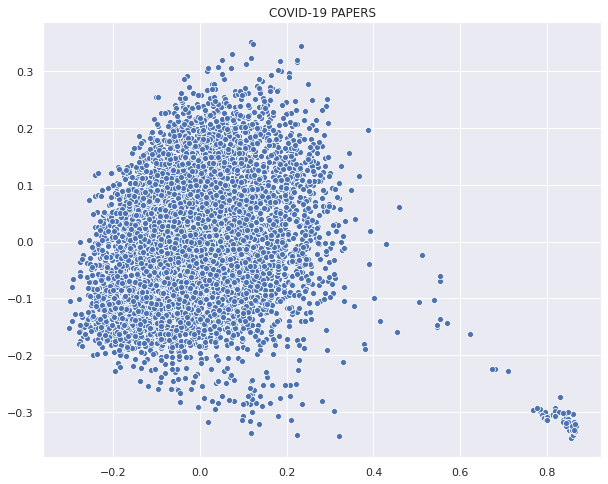

In [159]:
sn.set(rc = {'figure.figsize': (10,8)})
sn.scatterplot(X_pca[:,0], X_pca[:,1])
plt.title('COVID-19 PAPERS')

# Defining the numbe of the clusters:

Text(0, 0.5, 'WCSS')

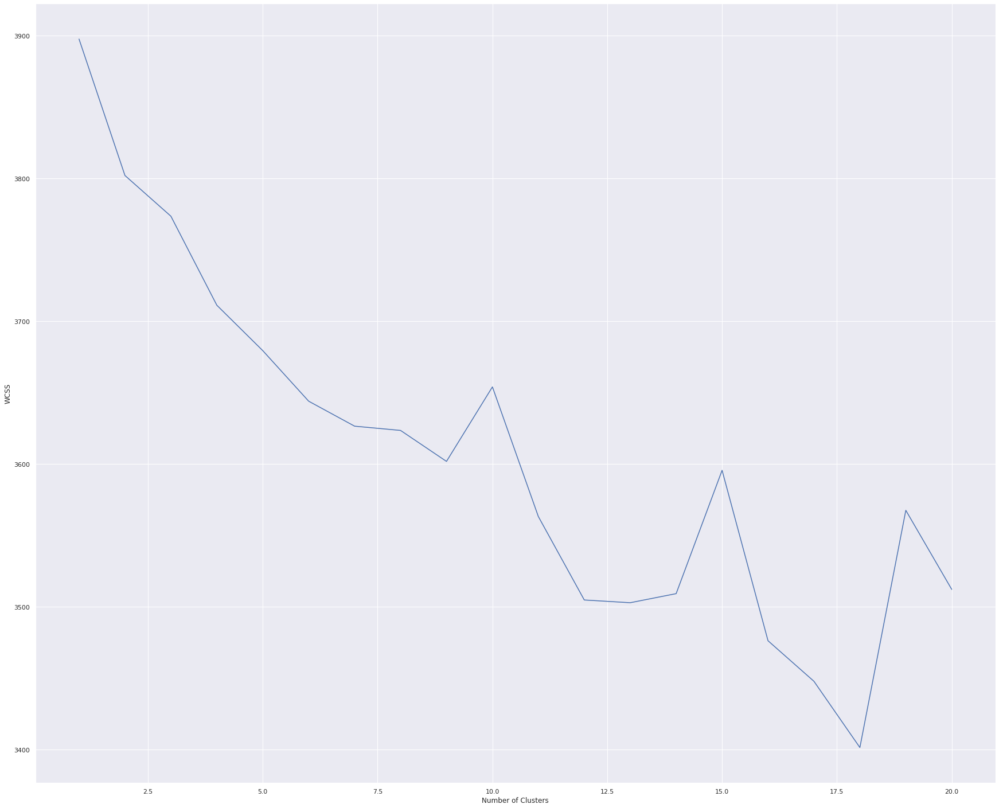

In [165]:
from sklearn.cluster import MiniBatchKMeans

wcss = []
for i in range(1,21): #let's execute 21 times
  kmeans = MiniBatchKMeans(n_clusters = i, random_state = 0)
  kmeans.fit(vectorized)
  wcss.append(kmeans.inertia_)

plt.plot(range(1,21), wcss)
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')

*The higher the ``WCSS`` value, the worse the coice of ``clusters``*

The graph is only a refrence wich numbers of clusters we will choose.

In [171]:
k = 4 
kmeans = MiniBatchKMeans(n_clusters = k)
y_pred = kmeans.fit_predict(vectorized)

Let's see the graph with all clusters:

Text(0.5, 1.0, 'Number of Clustered COVID-19 Papers')

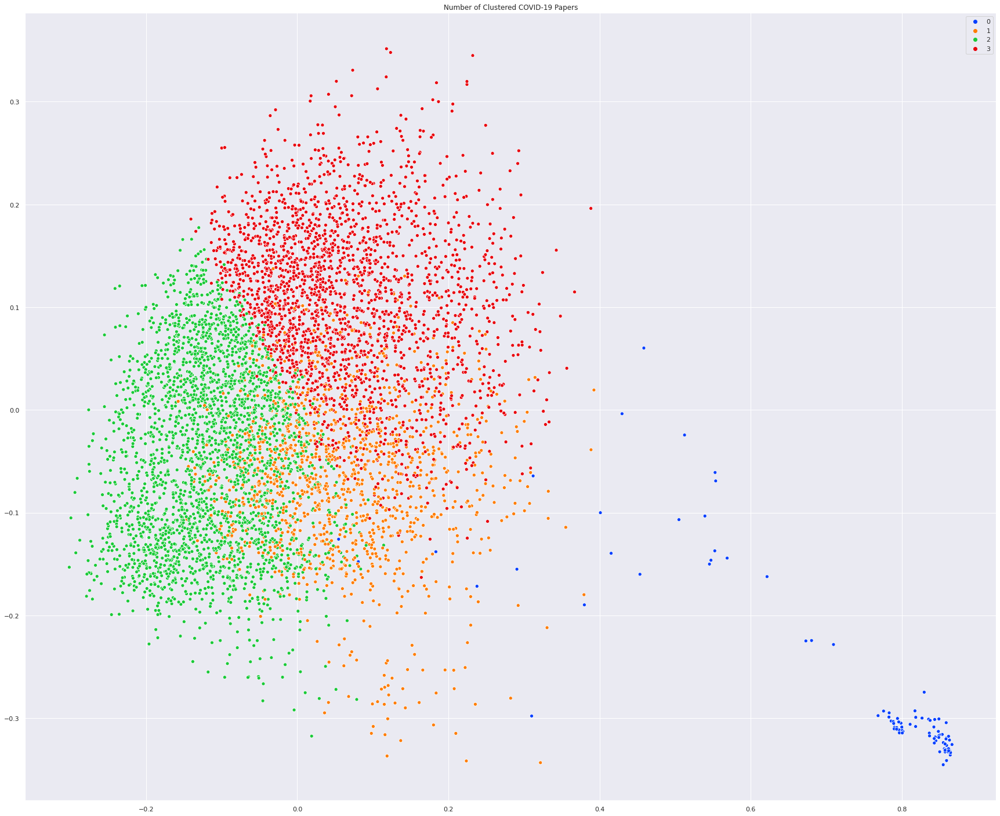

In [172]:
palette = sn.color_palette('bright', len(set(y_pred)))
sn.scatterplot(X_pca[:, 0], X_pca[:,1], hue = y_pred, legend = 'full', palette = palette)
plt.title('Number of Clustered COVID-19 Papers')